In [1]:
import pandas as pd
import numpy as np
import json 
import urllib.request
import io
import requests
from PyPDF2 import PdfFileReader
import re
import pytz
from dateutil.relativedelta import *
from dateutil.easter import *
from dateutil.rrule import *
from dateutil.parser import *
from datetime import datetime
from datetime import *
from urllib.request import urlopen
from bs4 import BeautifulSoup
import pandas as pd
import numpy as np
from tqdm import tqdm
import nltk
from gensim.models.doc2vec import TaggedDocument
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
# nltk.download('punkt')
# nltk.download('averaged_perceptron_tagger')
# nltk.download('stopwords')
# nltk.download('wordnet')
# nltk.download('omw-1.4')
from bertopic import BERTopic
from nltk import bigrams
from nltk import ConditionalFreqDist
from nltk.probability import ConditionalProbDist, MLEProbDist
import networkx as nx
from matplotlib import *
import sys
from pylab import *
from networkx.drawing.nx_pydot import graphviz_layout
import matplotlib.pyplot as plt
from collections import Counter

In [2]:
import ssl
ssl._create_default_https_context = ssl._create_unverified_context

In [3]:
# #기간 1 데이터 읽기
# hynix_df1 = pd.read_csv('hynix_df1.csv', sep='\t')
# hynix_df1

In [4]:
# #기간 2 데이터 읽기
# hynix_df2 = pd.read_csv('hynix_df2.csv', sep='\t')
# hynix_df2

In [5]:
# #기간 3 데이터 읽기
# hynix_df3 = pd.read_csv('hynix_df3.csv', sep='\t')
# hynix_df3

In [6]:
# #전테 데이터 읽기 
# hynix_df_all = pd.read_csv('hynix_df_all.csv', sep='\t')
# hynix_df_all

In [7]:
# 3년 단위로 기간별로 나눠서 분석
url1 = 'https://developer.uspto.gov/ibd-api/v1/application/grants?searchText=Hynix&grantFromDate=2014-01-01&grantToDate=2015-12-31&descriptionText=DRAM'
url2 = 'https://developer.uspto.gov/ibd-api/v1/application/grants?searchText=Hynix&grantFromDate=2016-01-01&grantToDate=2017-12-31&descriptionText=DRAM'
url3 = 'https://developer.uspto.gov/ibd-api/v1/application/grants?searchText=Hynix&grantFromDate=2018-01-01&grantToDate=2019-12-31&descriptionText=DRAM'

##### 크롤링

In [8]:
# 기간 1에 대한 크롤링
n = 7 #100개씩 나눠진 총 patent 개수에 따라 정해짐. 
# n을 반복하면서 DF 읽어와서 완성. 
hynix_df1 = pd.DataFrame()
for i in range(n):
    url1_1 = f'https://developer.uspto.gov/ibd-api/v1/application/grants?searchText=Hynix&grantFromDate=2014-01-01&grantToDate=2015-12-31&descriptionText=DRAM&start={i}00'
    hynix_page1_1 = urllib.request.urlopen(url1_1)
    hynix_data1_1 = json.loads(hynix_page1_1.read().decode('utf-8'))
    hynix_list1_1 = []
    for idx, data in enumerate(hynix_data1_1['results']):
        new_data = data
        hynix_list1_1.append(new_data)
    hynix_df1_1 = pd.DataFrame(hynix_list1_1)
    # .drop(['inventionSubjectMatterCategory', 'filelocationURI', 'archiveURI'], axis = 1)
    hynix_df1 = pd.concat([hynix_df1, hynix_df1_1], ignore_index= True)

# 기간 1 저장
hynix_df1.to_csv("hynix_df1.csv", mode='w', sep="\t")

In [9]:
# 기간 2에 대한 크롤링
hynix_df2 = pd.DataFrame()
n = 6 #100개씩 나눠진 총 patent 개수에 따라 정해짐. 

for i in range(n):
    url2_1 = f'https://developer.uspto.gov/ibd-api/v1/application/grants?searchText=Hynix&grantFromDate=2016-01-01&grantToDate=2017-12-31&descriptionText=DRAM&start={i}00'
    hynix_page2_1 = urllib.request.urlopen(url2_1)
    hynix_data2_1 = json.loads(hynix_page2_1.read().decode('utf-8'))
    hynix_list2_1 = []
    for idx, data in enumerate(hynix_data2_1['results']):
        new_data = data
        hynix_list2_1.append(new_data)
    hynix_df2_1 = pd.DataFrame(hynix_list2_1)
    hynix_df2 = pd.concat([hynix_df2, hynix_df2_1], ignore_index= True)

# 기간 2 저장 
hynix_df2.to_csv("hynix_df2.csv", mode='w', sep="\t")

In [10]:
# 기간 3에 대한 크롤링
hynix_df3 = pd.DataFrame()
n = 3 #100개씩 나눠진 총 patent 개수에 따라 정해짐. 
for i in range(n):
    url3_1 = f'https://developer.uspto.gov/ibd-api/v1/application/grants?searchText=Hynix&grantFromDate=2018-01-01&grantToDate=2019-12-31&descriptionText=DRAM&start={i}00'
    hynix_page3_1 = urllib.request.urlopen(url3_1)
    hynix_data3_1 = json.loads(hynix_page3_1.read().decode('utf-8'))
    hynix_list3_1 = []
    for idx, data in enumerate(hynix_data3_1['results']):
        new_data = data
        hynix_list3_1.append(new_data)
    hynix_df3_1 = pd.DataFrame(hynix_list3_1)
    hynix_df3 = pd.concat([hynix_df3, hynix_df3_1], ignore_index= True)

#기간 3 저장 
hynix_df3.to_csv("hynix_df3.csv", mode='w', sep="\t")

In [28]:
# 기간 1, 2, 3 합쳐서 전체 데이터 만들기. 
hynix_df_all = pd.concat([hynix_df1, hynix_df2, hynix_df3], ignore_index= True)
hynix_df_all.drop(['inventionSubjectMatterCategory', 'filelocationURI', 'archiveURI'], axis = 1)
hynix_df_all.to_csv("hynix_df_all.csv", mode='w', sep="\t")

In [17]:
#이 중에서 filing date와 grantdate 보기 위해 날자 df만 따로 만들기 
hynix_date_all = pd.concat([hynix_df_all.filingDate, hynix_df_all.grantDate], axis=1)
#datetime으로 변환 
hynix_date_all['filingDate'] = pd.to_datetime(hynix_date_all['filingDate'])
hynix_date_all['grantDate'] = pd.to_datetime(hynix_date_all['grantDate'])

In [22]:
hynix_date = hynix_date_all['grantDate'] - hynix_date_all['filingDate']

In [27]:
hynix_date.mean()

Timedelta('708 days 14:00:00')

In [29]:
hynix_date_all.to_csv("hynix_date_all.csv", mode='w', sep=",", index=False)

In [114]:
# hynix_df_all.to_excel("hynix_df_all.xlsx")

##### 텍스트 변환

In [35]:
# depcription 컬럼을 텍스트 변환 
hynix_df_all['description']=hynix_df_all['descriptionText'].astype(str)

In [55]:
# Description text에 대해 corpus 처리 
import re
from nltk.tokenize import sent_tokenize, word_tokenize

def english_corpus_processing(corpus):
    # 문장부호 , . , ? ! \ " ' $ % ( : ; 등을 제거한다.
    # 숫자를 제거한다.
    # 과도한 띄어쓰기, 줄뜨임 제거
    preprocess = re.compile('[^a-z]').sub(' ', str(corpus).lower()).replace('\n',' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ')

    # 1st : tokenization
    cleaned_corpus_1st = []
    for string in word_tokenize(preprocess):
        tokens = re.sub(r"[^a-z0-9]+", " ", string.lower())
        cleaned_corpus_1st.append(tokens)

    #pos 태깅
    tokens_pos = nltk.pos_tag(cleaned_corpus_1st)
    #명사만 추출
    NN_words = []
    for word, pos in tokens_pos:
        if 'NN' in pos:
            NN_words.append(word)

    #불용어 리스트    
    stopwords_list = stopwords.words('english') #nltk에서 제공하는 불용어사전 이용
    unique_NN_words = set(NN_words)   #set을 사용해 중복 제거
    final_NN_words = NN_words
    # 아래와 같이 추가로 직접 만든 불용어사전을 이용해 불용어 제거
    customized_stopwords = ['be', 'korean', 'invention', 'relates', 'priority', 'application', 'present', 'patent', 'claims', 'number', 'filed', 'incorporated', 'reference', 'entirety', 'signal', 'first', 'second', '.', ',', 'may', 'line', 'data', 'jul', 'filed', 'disclosure', 'hereby', 'entirety', 'invention', 'may', 'that', 'embodiments', 'embodiment']  # 직접 만든 불용어 사전
    stopwords_list.extend(list(set(customized_stopwords)))
    
    # 불용어 제거
    for word in unique_NN_words:
        if word in stopwords_list:
            while word in final_NN_words: final_NN_words.remove(word)

    # Lemmatization 표제어 추출
    for i in range(len(final_NN_words)):
        final_NN_words[i] = WordNetLemmatizer().lemmatize(final_NN_words[i])

    # 3rd : 기타 처리
    # 영어의 경우 두 글자 단어까지는 대명사나 조사 접속사 등으로 쓰이는 경우가 많아 제외해도 된다. 여기서는 여기에 더해 'the'까지 제외할 것이다.
    # 최소 횟수 이하 단어를 제거하는 작업을 한다. 여기서는 6번을 기준으로 한다.
    cleaned_corpus_3rd = []
    for i in range(len(final_NN_words)):
        if len(final_NN_words[i]) <= 2 or final_NN_words[i] == 'the':
            continue
        else:
            if final_NN_words.count(final_NN_words[i]) <= 5:
                continue
            else:
                cleaned_corpus_3rd.append(final_NN_words[i])

    #최종 단어들을 다시 하나의 str으로 만든다.     
    result = " ".join(cleaned_corpus_3rd)
 
    return result


In [56]:
#위에서 만든 자연어 처리 함수 적용
des_str = hynix_df_all['description'].apply(english_corpus_processing)

In [58]:
#저장
des_str.to_csv("des_str.csv", mode='w', sep="\t")

In [6]:
# des_str = pd.read_csv('des_str.csv', sep='\t')

0       method semiconductor device contact semiconduc...
1       semiconductor package method semiconductor chi...
2       semiconductor device method semiconductor devi...
3       semiconductor technology semiconductor package...
4       semiconductor semiconductor device driving cir...
                              ...                        
1363    bitmap herein system method storage device mem...
1364    circuit semiconductor device voltage output dr...
1365    path error purpose memory device example memor...
1366    controller path architecture tlc nand controll...
1367    window ftl memory device drive example disk dr...
Name: description, Length: 1368, dtype: object

##### BERTopic

In [61]:
#BERTopic 모델 불러와서 써서 topic과 probability 받아보기
from bertopic import BERTopic
model = BERTopic(verbose=True,embedding_model='paraphrase-MiniLM-L3-v2', min_topic_size= 15)
topics, probabilities = model.fit_transform(des_str)

Batches:   0%|          | 0/43 [00:00<?, ?it/s]

2023-02-09 14:48:49,168 - BERTopic - Transformed documents to Embeddings
2023-02-09 14:48:57,801 - BERTopic - Reduced dimensionality
2023-02-09 14:48:57,859 - BERTopic - Clustered reduced embeddings


In [62]:
#topic들의 정보를 받아서 종 토픽 개수를 보기
freq = model.get_topic_info()
print("Number of topics: {}".format( len(freq)))
freq

Number of topics: 21


,Topic,Count,Name
0,-1,272,-1_memory_unit_cell_voltage
1,0,190,0_memory_cell_program_voltage
2,1,178,1_memory_block_device_page
3,2,84,2_region_body_layer_gate
4,3,84,3_layer_channel_slit_charge
5,4,68,4_work_function_gate_layer
6,5,56,5_chip_package_semiconductor_bump
7,6,54,6_clock_delay_unit_output
8,7,49,7_voltage_level_power_supply
9,8,40,8_air_plug_spacer_gap


In [65]:
for i in range(len(freq)):
    topic = freq.iloc[i]["Topic"] # Select the 1st topic
    topics = model.get_topic(topic) # Show the words and their c-TF-IDF scores
    print(f'Topic_{i}')
    print(pd.DataFrame(topics))

Topic_0
               0         1
0         memory  0.039672
1           unit  0.031201
2           cell  0.027687
3        voltage  0.026843
4         output  0.026415
5      operation  0.025598
6         device  0.024755
7        address  0.023945
8            bit  0.023453
9  semiconductor  0.023062
Topic_1
           0         1
0     memory  0.056306
1       cell  0.053381
2    program  0.052394
3    voltage  0.051955
4      block  0.044977
5  operation  0.044952
6       word  0.038827
7       line  0.037996
8     device  0.032364
9  selection  0.032017
Topic_2
            0         1
0      memory  0.070433
1       block  0.066245
2      device  0.049526
3        page  0.047074
4  controller  0.044646
5        host  0.041677
6   operation  0.037724
7     command  0.035128
8      system  0.034599
9     example  0.031446
Topic_3
           0         1
0     region  0.073194
1       body  0.064106
2      layer  0.062405
3       gate  0.051809
4       type  0.048595
5        bit  0.

In [66]:
model.visualize_topics()

In [67]:
model.visualize_barchart(top_n_topics=17)

#### 단어 네트워크

In [19]:
# hynix_df1 = pd.read_csv('hynix_df1.csv', sep='\t')

,Unnamed: 0,inventionSubjectMatterCategory,patentApplicationNumber,filingDate,mainCPCSymbolText,furtherCPCSymbolArrayText,inventorNameArrayText,abstractText,assigneeEntityName,assigneePostalAddressText,inventionTitle,filelocationURI,archiveURI,claimText,descriptionText,grantDocumentIdentifier,grantDate,patentNumber
0,0,utility,US13494923,06-12-2012,NaN,NaN,['Kim Do Hyung'],['A method for manufacturing a semiconductor d...,Hynix Semicondutor Inc.,"Icheon, KR",Method for manufacturing a semiconductor devic...,https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,['1. A method for manufacturing a semiconducto...,['This application is a divisional of U.S. pat...,US08623723B2,01-07-2014,8623723
1,1,utility,US13307197,11-30-2011,NaN,NaN,['Oh Tac Keun'],['A semiconductor chip includes: a first subst...,SK Hynix Inc.,"Gyeonggi-do, KR","Semiconductor chip, stack-type semiconductor p...",https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,['1. A semiconductor chip comprising:a first s...,['The present application claims priority unde...,US08624241B2,01-07-2014,8624241
2,2,utility,US13243386,09-23-2011,NaN,NaN,"['Kim Do Hyung', 'Cho Young Man']",['The invention relates to a semiconductor dev...,Hynix Semiconductor Inc.,"Icheon, KR",Semiconductor device and method of fabricating...,https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,"['1. A semiconductor device , comprising:firs...",['The present application claims priority to K...,US08624350B2,01-07-2014,8624350
3,3,utility,US12981463,12-29-2010,NaN,NaN,"['Min Bok Gyu', 'Hong Joon Ki', 'Kim Tae Hoon'...","['A semiconductor package includes: first, sec...",SK Hynix Inc.,"Gyeonggi-do, KR",Semiconductor package for selecting semiconduc...,https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,['1. A semiconductor package comprising:a plur...,['The present application claims priority unde...,US08624375B2,01-07-2014,8624375
4,4,utility,US13446455,04-13-2012,NaN,NaN,['Kim Yong-Mi'],['A semiconductor device includes an informati...,Hynix Semiconductor Inc.,"Gyeonggi-do, KR",Semiconductor device including driving circuit,https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,"['1. A semiconductor device , comprising:an i...",['The present application claims priority of K...,US08624638B2,01-07-2014,8624638
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
616,616,utility,US14533795,11-05-2014,H01L27/10885,"['H01L21/265', 'H01L21/30604', 'H01L21/76224',...",['Yang Ki Ho'],['The semiconductor device includes word lines...,SK Hynix Inc.,"Gyeonggi-do, KR",Semiconductor devices including vertical trans...,https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,['1. A method of manufacturing a semiconductor...,['The present application claims priority unde...,US09224741B2,12-29-2015,9224741
617,617,utility,US14453403,08-06-2014,H01L27/11582,"['H01L21/76841', 'H01L21/76871', 'H01L21/76879...","['Hyun Chan Sun', 'Ahn Myung Kyu', 'Kwon Woo J...",['A semiconductor device includes interlayer d...,SK Hynix Inc.,"Gyeonggi-do, KR",Three-dimensional (3D) semiconductor device,https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,['1. A semiconductor device comprising:interla...,['The present application claims priority to K...,US09224751B2,12-29-2015,9224751
618,618,utility,US14704671,05-05-2015,H01L29/66666,['H01L27/2454'],['Park Nam Kyun'],"['A semiconductor device, a resistive memory d...",SK Hynix Inc.,"Gyeonggi-do, KR","Semiconductor device having vertical channel, ...",https://dh-opendata.s3.amazonaws.com/grant_pdf...,https://bulkdata.uspto.gov/data/patent/grant/r...,['1. A method of manufacturing a semiconductor...,['This application is a division of U.S. paten...

In [77]:
#스트링 처리
hynix_df1['description']=hynix_df1['descriptionText'].astype(str)
des_str_net = ' '.join(hynix_df1['description'])
# 특수기호 제거
filtered_des_net = re.sub('[^.,?!\s\w]','',des_str_net).lower() 

In [ ]:
# Description text에 대해 corpus 처리 
import re
from nltk.tokenize import sent_tokenize, word_tokenize

def english_corpus_processing(corpus):
    # 문장부호 , . , ? ! \ " ' $ % ( : ; 등을 제거한다.
    # 숫자를 제거한다.
    # 과도한 띄어쓰기, 줄뜨임 제거
    preprocess = re.compile('[^a-z]').sub(' ', str(corpus).lower()).replace('\n',' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ').replace('  ', ' ')

    # 1st : tokenization
    cleaned_corpus_1st = []
    for string in word_tokenize(preprocess):
        tokens = re.sub(r"[^a-z0-9]+", " ", string.lower())
        cleaned_corpus_1st.append(tokens)

    #pos 태깅
    tokens_pos = nltk.pos_tag(cleaned_corpus_1st)
    #명사만 추출
    NN_words = []
    for word, pos in tokens_pos:
        if 'NN' in pos:
            NN_words.append(word)

    #불용어 리스트    
    stopwords_list = stopwords.words('english') #nltk에서 제공하는 불용어사전 이용
    unique_NN_words = set(NN_words)   #set을 사용해 중복 제거
    final_NN_words = NN_words
    # 아래와 같이 추가로 직접 만든 불용어사전을 이용해 불용어 제거
    customized_stopwords = ['be', 'korean', 'invention', 'relates', 'priority', 'application', 'present', 'patent', 'claims', 'number', 'filed', 'incorporated', 'reference', 'entirety', 'signal', 'first', 'second', '.', ',', 'may', 'line', 'data', 'jul', 'filed', 'disclosure', 'hereby', 'entirety', 'invention', 'may', 'that', 'embodiments', 'embodiment']  # 직접 만든 불용어 사전
    stopwords_list.extend(list(set(customized_stopwords)))
    
    # 불용어 제거
    for word in unique_NN_words:
        if word in stopwords_list:
            while word in final_NN_words: final_NN_words.remove(word)

    # Lemmatization 표제어 추출
    for i in range(len(final_NN_words)):
        final_NN_words[i] = WordNetLemmatizer().lemmatize(final_NN_words[i])

    # 3rd : 기타 처리
    # 영어의 경우 두 글자 단어까지는 대명사나 조사 접속사 등으로 쓰이는 경우가 많아 제외해도 된다. 여기서는 여기에 더해 'the'까지 제외할 것이다.
    # 최소 횟수 이하 단어를 제거하는 작업을 한다. 여기서는 6번을 기준으로 한다.
    cleaned_corpus_3rd = []
    for i in range(len(final_NN_words)):
        if len(final_NN_words[i]) <= 2 or final_NN_words[i] == 'the':
            continue
        else:
            if final_NN_words.count(final_NN_words[i]) <= 5:
                continue
            else:
                cleaned_corpus_3rd.append(final_NN_words[i])

    #최종 단어들을 다시 하나의 str으로 만든다.     
    result = " ".join(cleaned_corpus_3rd)
 
    return result

In [82]:
des_str_1 = english_corpus_processing(des_str_net)
des_str_1[:100]

In [78]:
word_tokens_net = nltk.word_tokenize(filtered_des_net)
tokens_pos_net = nltk.pos_tag(word_tokens_net)

In [79]:
NN_words1 = []
for word, pos in tokens_pos_net:
    if 'NN' in pos:
        NN_words1.append(word)

In [80]:
wlem_net = nltk.WordNetLemmatizer()
lemmatized_words_1 = []

for word in NN_words1:
    new_word = wlem_net.lemmatize(word)
    lemmatized_words_1.append(new_word)

In [81]:
stopwords_list_1 = stopwords.words('english') #nltk에서 제공하는 불용어사전 이용
unique_NN_words_1 = set(lemmatized_words_1)   #set을 사용해 중복 제거
final_NN_words_1 = lemmatized_words_1

 # 아래와 같이 추가로 직접 만든 불용어사전을 이용해 불용어 제거
customized_stopwords = ['be', 'korean', 'invention', 'relates', 'priority', 'application', 'present', 'patent', 'claims', 'number', 'filed', 'incorporated', 'reference', 'entirety', 'signal', 'first', 'second', '.', ',', 'may', 'line', 'data', 'jul', 'filed', 'disclosure', 'hereby', 'entirety', 'invention', 'may', 'that', 'embodiments', 'embodiment']  # 직접 만든 불용어 사전
stopwords_list_1.extend(list(set(customized_stopwords)))

for word in unique_NN_words_1:
    if word in stopwords_list_1:
        while word in final_NN_words_1: final_NN_words_1.remove(word)

 ## final_NN_words 출력해보기
print(unique_NN_words_1[:10])

TypeError: 'set' object is not subscriptable

In [25]:
import csv
with open("final_NN_words1.csv", 'w', encoding='utf-8', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(final_NN_words_1)

In [13]:
# import csv
# with open('final_NN_words1.csv', encoding='utf-8', newline='') as f:
#     reader = csv.reader(f)
#     final_NN_words_n = list(reader)
# final_NN_words_n= final_NN_words_n[0]

['ser',
 'dec.',
 'apr',
 'reference.embodiments',
 'relate',
 'method',
 'semiconductor',
 'device',
 'contact',
 'semiconductor',
 'device',
 'method',
 'contact.generally',
 'semiconductor',
 'material',
 'conductivity',
 'region',
 'conductor',
 'nonconductor',
 'semiconductor',
 'nonconductor',
 'pure',
 'state',
 'conductivity',
 'semiconductor',
 'device',
 'manipulation',
 'semiconductor',
 'semiconductor',
 'device',
 'transistor',
 'doping',
 'deposition',
 'removal',
 'process',
 'example',
 'semiconductor',
 'device',
 'semiconductor',
 'memory',
 'device',
 'semiconductor',
 'memory',
 'device',
 'variety',
 'element',
 'transistor',
 'capacitor',
 'element',
 'contact',
 'semiconductor',
 'memory',
 'device',
 'power',
 'consumption',
 'increase',
 'speed.as',
 'design',
 'rule',
 'nm',
 'integration',
 'degree',
 'semiconductor',
 'memory',
 'device',
 'area',
 'element',
 'semiconductor',
 'memory',
 'device',
 'problem',
 'example',
 'channel',
 'length',
 'transistor'

###### Bi-gram 만들자

In [26]:
#bi-gram을 만들자. 
bi_tokens1 = []
for i in range(len(final_NN_words_1) - 1):      # 2-gram이므로 리스트의 마지막에서 요소 한 개 앞까지만 반복함
    bi_tokens1.append(final_NN_words_1[i]+' '+final_NN_words_1[i + 1]) 

customized_stopwords_b = ['semiconductor device', 'memory semiconductor', 'semiconductor memory', 'memory apparatus', 'memory device', 'semiconductor apparatus', 'layer layer']  # 직접 만든 불용어 사전
unique_NN_words_b1 = set(bi_tokens1)

for word in unique_NN_words_b1:
    if word in customized_stopwords_b:
        while word in bi_tokens1: bi_tokens1.remove(word)

['ser dec.',
 'dec. apr',
 'apr reference.embodiments',
 'reference.embodiments relate',
 'relate method',
 'method semiconductor',
 'device contact',
 'contact semiconductor',
 'device method',
 'method contact.generally',
 'contact.generally semiconductor',
 'semiconductor material',
 'material conductivity',
 'conductivity region',
 'region conductor',
 'conductor nonconductor',
 'nonconductor semiconductor',
 'semiconductor nonconductor',
 'nonconductor pure',
 'pure state',
 'state conductivity',
 'conductivity semiconductor',
 'device manipulation',
 'manipulation semiconductor',
 'semiconductor semiconductor',
 'device transistor',
 'transistor doping',
 'doping deposition',
 'deposition removal',
 'removal process',
 'process example',
 'example semiconductor',
 'device semiconductor',
 'device semiconductor',
 'device variety',
 'variety element',
 'element transistor',
 'transistor capacitor',
 'capacitor element',
 'element contact',
 'contact semiconductor',
 'device power'

In [28]:
with open("bi_tokens1.csv", 'w', encoding='utf-8', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(bi_tokens1)

In [14]:
# #읽기
# import csv
# with open('bi_tokens1.csv', encoding='utf-8', newline='') as f:
#     reader = csv.reader(f)
#     bi_tokens1 = list(reader)
# bi_tokens1= bi_tokens1[0]

['ser dec.',
 'dec. apr',
 'apr reference.embodiments',
 'reference.embodiments relate',
 'relate method',
 'method semiconductor',
 'device contact',
 'contact semiconductor',
 'device method',
 'method contact.generally',
 'contact.generally semiconductor',
 'semiconductor material',
 'material conductivity',
 'conductivity region',
 'region conductor',
 'conductor nonconductor',
 'nonconductor semiconductor',
 'semiconductor nonconductor',
 'nonconductor pure',
 'pure state',
 'state conductivity',
 'conductivity semiconductor',
 'device manipulation',
 'manipulation semiconductor',
 'semiconductor semiconductor',
 'device transistor',
 'transistor doping',
 'doping deposition',
 'deposition removal',
 'removal process',
 'process example',
 'example semiconductor',
 'device semiconductor',
 'device semiconductor',
 'device variety',
 'variety element',
 'element transistor',
 'transistor capacitor',
 'capacitor element',
 'element contact',
 'contact semiconductor',
 'device power'

In [15]:
#각 bigram이 얼마나 자주 나왔는지 확인 
bi_counter1 = Counter(bi_tokens1)
bi_counter1.most_common(20)

[('memory cell', 8475),
 ('insulation layer', 3184),
 ('channel layer', 2908),
 ('material layer', 2883),
 ('memory block', 2853),
 ('semiconductor substrate', 2810),
 ('semiconductor chip', 2794),
 ('contact plug', 2319),
 ('device memory', 2130),
 ('mask pattern', 1947),
 ('voltage level', 1862),
 ('gate electrode', 1713),
 ('layer material', 1636),
 ('storage contact', 1590),
 ('generation unit', 1588),
 ('cell array', 1585),
 ('control unit', 1569),
 ('silicon layer', 1539),
 ('memory controller', 1510),
 ('layer surface', 1505)]

In [16]:
#가장 많이 나온 n개 뽑아보자
freq_n = 20
freq_df1 = pd.DataFrame.from_records(bi_counter1.most_common(freq_n), columns = ['token', 'count'])

,token,count
0,memory cell,8475
1,insulation layer,3184
2,channel layer,2908
3,material layer,2883
4,memory block,2853
5,semiconductor substrate,2810
6,semiconductor chip,2794
7,contact plug,2319
8,device memory,2130
9,mask pattern,1947


In [144]:
freq_df1.to_csv("freq_df1.csv", mode='w', sep=",", index=False)

###### 네트워크 그래프를 만들어보자. 

In [17]:
#가장 많이 나온 40개 정도를 뽑아서 리스트로 저장.
freq_n = 39
list_of_bitokens1 = []
for word, count in bi_counter1.most_common(freq_n):
    list_of_bitokens1.append(word)

['memory cell', 'insulation layer', 'channel layer', 'material layer', 'memory block', 'semiconductor substrate', 'semiconductor chip', 'contact plug', 'device memory', 'mask pattern', 'voltage level', 'gate electrode', 'layer material', 'storage contact', 'generation unit', 'cell array', 'control unit', 'silicon layer', 'memory controller', 'layer surface', 'air gap', 'interlayer layer', 'layer pattern', 'memory system', 'storage node', 'contact hole', 'isolation layer', 'metal layer', 'method semiconductor', 'layer gate', 'region region', 'program operation', 'mask layer', 'cell memory', 'gate layer', 'insulating layer', 'bit bl', 'plurality memory', 'cell region']


In [18]:
removals = ['layer material', 'method semiconductor', 'device memory', 'region region', 'semiconductor chip', 'cell memory', 'memory cell', 'cell array', 'bit bl']
for  i in removals: 
    list_of_bitokens1.remove(i) 

# list_of_bitokens1.remove('layer material')
# list_of_bitokens1.remove('method semiconductor')
# list_of_bitokens1.remove('device memory')
# list_of_bitokens1.remove('region region')
# list_of_bitokens1.remove('semiconductor chip')
# list_of_bitokens1.remove('cell memory')
# list_of_bitokens1.remove('memory cell')
# list_of_bitokens1.remove('cell array')
# list_of_bitokens1.remove('bit bl')

In [19]:
 # 가장 많이 출현하는 10개의 명사 단어들을 node로 하는 network 생성
import networkx as nx

G_b1 = nx.Graph()   # undirected graph 생성
G_b1.add_nodes_from(list_of_bitokens1)   # node 생성 (가장 많았던 명사 단어 10개)

print(G_b1.nodes()) # nodes
print(G_b1.edges()) # edge, 즉 node 간의 관계는 아직 없는 상황

['insulation layer', 'channel layer', 'material layer', 'memory block', 'semiconductor substrate', 'contact plug', 'mask pattern', 'voltage level', 'gate electrode', 'storage contact', 'generation unit', 'control unit', 'silicon layer', 'memory controller', 'layer surface', 'air gap', 'interlayer layer', 'layer pattern', 'memory system', 'storage node', 'contact hole', 'isolation layer', 'metal layer', 'layer gate', 'program operation', 'mask layer', 'gate layer', 'insulating layer', 'plurality memory', 'cell region']
[]


In [20]:
# 위에서 만들어두었던 filtered_content을 활용해서 문장을 쪼갬. (., ?, ! 등 문장 구분자 꼭 필요)
sentences = filtered_des_net.split('.\n')   

sentences1 = []
sentences2 = []
sentences3 = []
sentences4 = []
for sentence in sentences:
    sentences1.extend(sentence.split('. '))
for sentence in sentences1:
    sentences2.extend(sentence.split('!'))
for sentence in sentences2:
    sentences3.extend(sentence.split('?'))
for sentence in sentences3:
    sentences4.extend(sentence.split('\'] [\''))
article_sentences1 = sentences4 
## 각 문장을 element로 담고 있는 list

['this application is a divisional of u.s', 'patent application ser', 'no', '12981,204, filed on dec', '29, 2010, which claims the priority of korean patent application no', '1020100035733 filed on 19 apr', '2010, the disclosure of which is hereby incorporated in its entirety by reference.embodiments of the present invention relate to a method for manufacturing a highlyintegrated semiconductor device, and more particularly to a contact that enables the highlyintegrated semiconductor device to be stably operated, and a method for manufacturing the contact.generally, a semiconductor is a material that has an electrical conductivity that falls in an intermediate region between a conductor and a nonconductor', 'although the semiconductor is similar to a nonconductor in a pure state, the conductivity of the semiconductor device may be increased by doping or other manipulation', 'the semiconductor is used to form a semiconductor device such as a transistor through doping and various depositi

In [145]:
article_sentences1_df = pd.DataFrame(article_sentences1)
article_sentences1_df

,0
0,this application is a divisional of u.s
1,patent application ser
2,no
3,"12981,204, filed on dec"
4,"29, 2010, which claims the priority of korean ..."
...,...
73849,"as described above with reference to , the len..."
73850,if the frequency of the clock which the filter...
73851,"after the lock signal lock is activated, the f..."
73852,if the filter unit operates in the low freque...


In [21]:
import itertools

for sentence in article_sentences1:  # 각 문장을 element로 담고 있는 list
    sentence = sentence.lower()
        
    word_tokens = nltk.word_tokenize(sentence)
    tokens_pos = nltk.pos_tag(word_tokens)

    NN_words = []  
    for word, pos in tokens_pos:
        if 'NN' in pos:
            NN_words.append(word)

    wlem = nltk.WordNetLemmatizer()
    lemmatized_words = []
    for word in NN_words:
        new_word = wlem.lemmatize(word)
        lemmatized_words.append(new_word)

    bi_tokens = []
    for i in range(len(lemmatized_words) - 1):      # 2-gram이므로 리스트의 마지막에서 요소 한 개 앞까지만 반복함
        bi_tokens.append(lemmatized_words[i]+' '+lemmatized_words[i + 1])    # 현재 문자열과 그다음 문자열 출력
        
    selected_words = []
    for word in bi_tokens:
        if word in list_of_bitokens1:
            selected_words.append(word)   # 빈도 top 10에 포함된 단어만 append
        
    selected_words = set(selected_words)   # 중복을 제거하기 위해 set(집합자료형)으로 변환
        

    for pair in list(itertools.combinations(list(selected_words), 2)):  
                    # itertools.combinations: selected_words 리스트에서 2개씩 골라 조합을 만들어준다
        if pair in G_b1.edges(): 
            weight = G_b1[pair[0]][pair[1]]['weight']
            weight += 1
            G_b1[pair[0]][pair[1]]['weight'] = weight    
        else:
            G_b1.add_edge(pair[0], pair[1], weight=1)


 # 생성된 edge 확인해보기
print(nx.get_edge_attributes(G_b1, 'weight'))

{('insulation layer', 'storage node'): 49, ('insulation layer', 'storage contact'): 112, ('insulation layer', 'cell region'): 54, ('insulation layer', 'contact hole'): 88, ('insulation layer', 'layer surface'): 213, ('insulation layer', 'semiconductor substrate'): 85, ('insulation layer', 'gate layer'): 29, ('insulation layer', 'layer gate'): 113, ('insulation layer', 'layer pattern'): 59, ('insulation layer', 'silicon layer'): 93, ('insulation layer', 'air gap'): 12, ('insulation layer', 'contact plug'): 63, ('insulation layer', 'metal layer'): 44, ('insulation layer', 'gate electrode'): 106, ('insulation layer', 'isolation layer'): 121, ('insulation layer', 'mask layer'): 45, ('insulation layer', 'interlayer layer'): 21, ('insulation layer', 'mask pattern'): 83, ('insulation layer', 'channel layer'): 51, ('insulation layer', 'material layer'): 45, ('insulation layer', 'memory block'): 4, ('insulation layer', 'memory controller'): 4, ('insulation layer', 'memory system'): 2, ('insulat

In [22]:
des_graph_b1 = nx.get_edge_attributes(G_b1, 'weight')
graph_df_b1 = pd.DataFrame.from_dict(des_graph_b1, orient='index')
graph_df_b1.columns = ['nodes_n']
graph_df_b1.sort_values(by='nodes_n', ascending=False)

,nodes_n
"(contact plug, storage contact)",587
"(memory controller, memory system)",436
"(storage contact, contact hole)",296
"(gate electrode, layer gate)",270
"(layer gate, gate layer)",256
...,...
"(memory block, layer pattern)",1
"(memory block, mask pattern)",1
"(memory system, mask layer)",1
"(storage node, isolation layer)",1


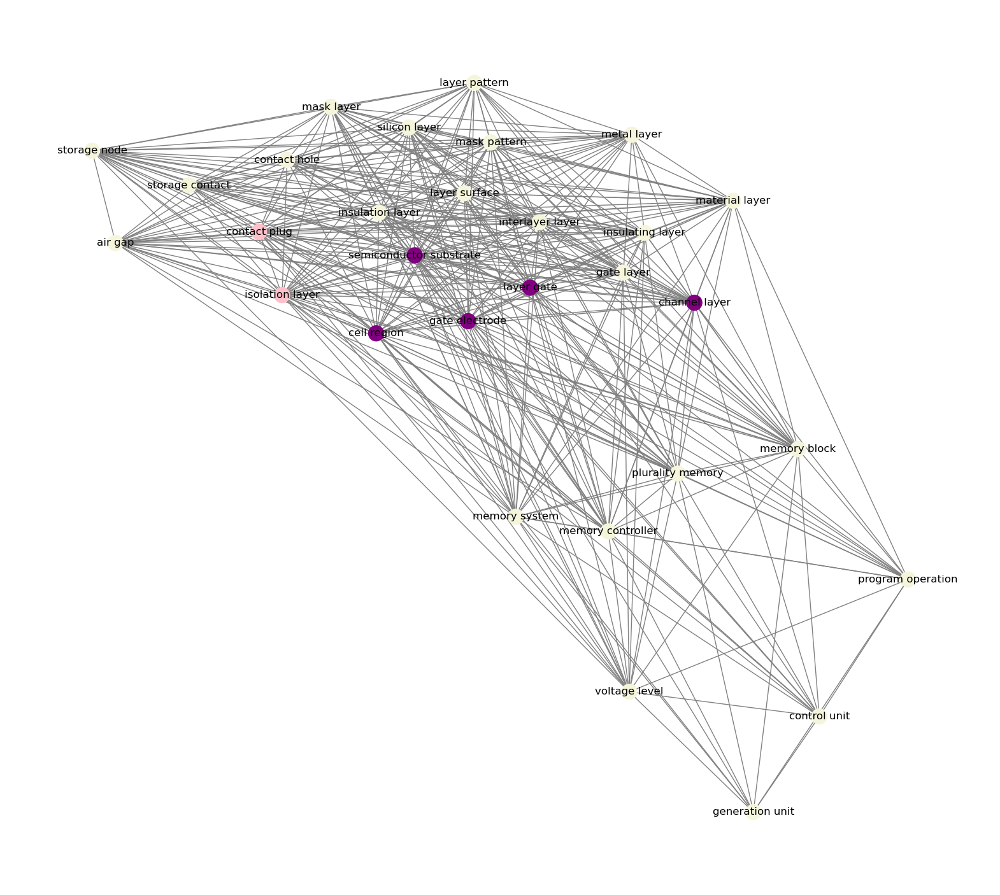

In [23]:
import matplotlib.pyplot as plt

## 노드의 degree에 따라 color 다르게 설정하기
color_map = []
for node in G_b1:
    if G_b1.degree(node) >= 28:   # 중요한 노드 (degree가 29 이상)
        color_map.append('purple')
    elif G_b1.degree(node) >= 27:   # 중요한 노드 (degree가 29 이상)
        color_map.append('pink') 
    else: 
        color_map.append('beige')    

plt.figure(figsize=(20, 18))  # size 설정

pos = nx.spring_layout(G_b1, scale=0.2)   # spring layout 사용, 글씨가 잘리는 것을 방지하기 위해 scale=0.2로 조정
nx.draw_networkx(G_b1, pos, node_color=color_map, edge_color='grey')

plt.axis('off') # turn off axis 
plt.show()

In [35]:
nx.density(G_b1)

0.825287356321839

In [106]:
deg_cent_b1 = nx.degree_centrality(G_b1)
deg_cent_b1 = deg_cent_b1.items()
deg_cent_b1_df = pd.DataFrame(deg_cent_b1, columns=['nodes', 'degree centrality'])
deg_cent_b1_df

,nodes,degree centrality
0,insulation layer,0.896552
1,channel layer,0.965517
2,material layer,0.896552
3,memory block,0.896552
4,semiconductor substrate,1.000000
5,contact plug,0.931034
6,mask pattern,0.862069
7,voltage level,0.655172
8,gate electrode,0.965517
9,storage contact,0.758621


In [107]:
bet_cent_b1= nx.betweenness_centrality(G_b1)
bet_cent_b1 = bet_cent_b1.items()
bet_cent_b1_df = pd.DataFrame(bet_cent_b1, columns=['nodes', 'betweenness centrality'])
bet_cent_b1_df

,nodes,betweenness centrality
0,insulation layer,0.005150
1,channel layer,0.011078
2,material layer,0.005150
3,memory block,0.015715
4,semiconductor substrate,0.020186
5,contact plug,0.006814
6,mask pattern,0.002042
7,voltage level,0.006558
8,gate electrode,0.011078
9,storage contact,0.000506


In [108]:
clos_cent_b1 = nx.closeness_centrality(G_b1)
clos_cent_b1 = clos_cent_b1.items()
clos_cent_b1_df = pd.DataFrame(clos_cent_b1, columns=['nodes', 'closeness centrality'])
clos_cent_b1_df

,nodes,closeness centrality
0,insulation layer,0.906250
1,channel layer,0.966667
2,material layer,0.906250
3,memory block,0.906250
4,semiconductor substrate,1.000000
5,contact plug,0.935484
6,mask pattern,0.878788
7,voltage level,0.743590
8,gate electrode,0.966667
9,storage contact,0.805556


In [109]:
eig_cent_b1 =  nx.eigenvector_centrality(G_b1, weight='weight')
#nx.eigenvector_centrality(g, weight='weight')라고 weight 옵션을 적어주면, 각 edge의 weight를 고려해서 centrality를 계산
eig_cent_b1 = eig_cent_b1.items()
eig_cent_b1_df = pd.DataFrame(eig_cent_b1, columns=['nodes', 'eigenvector centrality'])
eig_cent_b1_df

,nodes,eigenvector centrality
0,insulation layer,0.256985
1,channel layer,0.154667
2,material layer,0.130308
3,memory block,0.039219
4,semiconductor substrate,0.257562
5,contact plug,0.383825
6,mask pattern,0.163540
7,voltage level,0.006316
8,gate electrode,0.169456
9,storage contact,0.378694


In [110]:
clus_coef_b1 = nx.clustering(G_b1, weight='weight')
clus_coef_b1 = clus_coef_b1.items()
clus_coef_b1_df = pd.DataFrame(clus_coef_b1, columns= ['nodes', 'clustering coefficient'])
clus_coef_b1_df

,nodes,clustering coefficient
0,insulation layer,0.062966
1,channel layer,0.040592
2,material layer,0.043581
3,memory block,0.022199
4,semiconductor substrate,0.059116
5,contact plug,0.058189
6,mask pattern,0.052161
7,voltage level,0.012109
8,gate electrode,0.040737
9,storage contact,0.068619


In [111]:
cent_df_b1 = pd.concat([deg_cent_b1_df, bet_cent_b1_df['betweenness centrality'], clos_cent_b1_df['closeness centrality'], eig_cent_b1_df['eigenvector centrality'], clus_coef_b1_df['clustering coefficient']],axis=1)
cent_df_b1

,nodes,degree centrality,betweenness centrality,closeness centrality,eigenvector centrality,clustering coefficient
0,insulation layer,0.896552,0.005150,0.906250,0.256985,0.062966
1,channel layer,0.965517,0.011078,0.966667,0.154667,0.040592
2,material layer,0.896552,0.005150,0.906250,0.130308,0.043581
3,memory block,0.896552,0.015715,0.906250,0.039219,0.022199
4,semiconductor substrate,1.000000,0.020186,1.000000,0.257562,0.059116
5,contact plug,0.931034,0.006814,0.935484,0.383825,0.058189
6,mask pattern,0.862069,0.002042,0.878788,0.163540,0.052161
7,voltage level,0.655172,0.006558,0.743590,0.006316,0.012109
8,gate electrode,0.965517,0.011078,0.966667,0.169456,0.040737
9,storage contact,0.758621,0.000506,0.805556,0.378694,0.068619


In [112]:
cent_df_b1.to_csv("cent_df_b1.csv", mode='w', sep="\t")


In [8]:
cent_df_b1 = pd.read_csv('cent_df_b1.csv', sep='\t')
cent_df_b1

,Unnamed: 0,nodes,degree centrality,nodes.1,betweenness centrality,nodes.2,closeness centrality,nodes.3,eigenvector centrality,nodes.4,clustering coefficient
0,0,semiconductor substrate,1.000000,semiconductor substrate,0.020186,semiconductor substrate,1.000000,contact plug,0.383825,layer surface,0.077141
1,1,cell region,1.000000,cell region,0.020186,cell region,1.000000,storage contact,0.378694,contact hole,0.069979
2,2,channel layer,0.965517,memory block,0.015715,channel layer,0.966667,contact hole,0.281002,storage contact,0.068619
3,3,gate electrode,0.965517,plurality memory,0.012870,gate electrode,0.966667,layer surface,0.271392,insulation layer,0.062966
4,4,layer gate,0.965517,memory controller,0.012064,layer gate,0.966667,semiconductor substrate,0.257562,interlayer layer,0.060075
5,5,contact plug,0.931034,channel layer,0.011078,contact plug,0.935484,insulation layer,0.256985,semiconductor substrate,0.059116
6,6,isolation layer,0.931034,gate electrode,0.011078,isolation layer,0.935484,layer gate,0.234124,contact plug,0.058189
7,7,insulation layer,0.896552,layer gate,0.011078,insulation layer,0.906250,interlayer layer,0.196087,layer pattern,0.058117
8,8,material layer,0.896552,memory system,0.010839,material layer,0.906250,storage node,0.190124,layer gate,0.054586
9,9,memory block,0.896552,isolation layer,0.007971,memory block,0.906250,gate layer,0.178460,metal layer,0.054327


In [103]:
G_b1_n = pd.DataFrame(G_b1.degree(), columns=['id', 'degree'])
G_b1_n

,id,degree
0,insulation layer,26
1,channel layer,28
2,material layer,26
3,memory block,26
4,semiconductor substrate,29
5,contact plug,27
6,mask pattern,25
7,voltage level,19
8,gate electrode,28
9,storage contact,22


In [105]:
G_b1_n.to_csv("G_b1_n.csv", mode='w', sep=",", encoding='utf-8')

In [64]:
G_b1_w = pd.DataFrame(dict(G_b1.edges()).values())
G_b1_w

,weight
0,49
1,112
2,54
3,88
4,213
...,...
354,31
355,4
356,7
357,28


In [67]:
G_b1_edges = pd.DataFrame(dict(G_b1.edges()).keys(), columns=['source', 'target'])
G_b1_edges = pd.concat([G_b1_edges, G_b1_w], axis= 1)
G_b1_edges

,source,target,weight
0,insulation layer,storage node,49
1,insulation layer,storage contact,112
2,insulation layer,cell region,54
3,insulation layer,contact hole,88
4,insulation layer,layer surface,213
...,...,...,...
354,gate layer,cell region,31
355,gate layer,plurality memory,4
356,insulating layer,plurality memory,7
357,insulating layer,cell region,28


In [70]:
G_b1_edges.to_csv("G_b1_edges.csv", mode='w', sep="\t")

In [41]:
nx.write_gexf(G_b1,"hynix_g1.gexf")

In [73]:
#좌표 데이터 불러오기
coordinates = pd.read_excel('coordinates.xlsx', sheet_name='Sheet2')

#링크 데이터에 relationship 컬럼 생성
G_b1_edges['relationship'] = [pair[0] + '->' + pair[1] for pair in zip(G_b1_edges['source'], G_b1_edges['target'])]

# 태블로형 데이터로 변환
links_re = G_b1_edges[['target', 'weight', 'relationship']] #target ~ relationship 컬럼을 복사한 데이터프레임
links_re = links_re.rename(columns={'target': 'id'}) #두 데이터프레임을 합치기 위해 컬럼 이름 변경
links = G_b1_edges.rename(columns={'source': 'id'}) #두 데이터프레임을 합치기 위해 컬럼 이름 변경
del links['target'] #필요없는 target 컬럼 제거
links_concated = pd.concat([links, links_re]) #데이터 합치기

#좌표값을 merge해줍니다.
links_concated = pd.merge(links_concated, coordinates, on='id', how='left')

links_concated.to_csv('links_concated.csv') #데이터 저장